In [4]:
!nvidia-smi

Wed Apr 26 18:03:57 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [5]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [6]:
# Pip install method (recommended)

!pip install ultralytics==8.0.28

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 24.5/166.8 GB disk)


In [7]:
from ultralytics import YOLO

from IPython.display import display, Image

In [3]:
!mkdir {HOME}/datasets
%cd {HOME}/datasets

!pip install roboflow --quiet

from roboflow import Roboflow

rf = Roboflow(api_key="C9yZ97uSdNRP1Vb4QCXV")
project = rf.workspace("ece542nnproject").project("nn_project_200423")
dataset = project.version(2).download("yolov8")

mkdir: cannot create directory ‘{HOME}/datasets’: No such file or directory
[Errno 2] No such file or directory: '{HOME}/datasets'
/content
loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.28, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to NN_Project_200423-2 in yolov8:: 100%|██████████| 412/412 [00:00<00:00, 460.49it/s]


In [8]:
def freeze_layer(trainer):
    model = trainer.model
    num_freeze = 10
    print(f"Freezing {num_freeze} layers")
    freeze = [f'model.{x}.' for x in range(num_freeze)]  # layers to freeze 
    for k, v in model.named_parameters(): 
        v.requires_grad = True  # train all layers 
        if any(x in k for x in freeze): 
            print(f'freezing {k}') 
            v.requires_grad = False 
    print(f"{num_freeze} layers are freezed.")

In [11]:
from ultralytics import YOLO
model = YOLO("yolov8s-seg.pt")
model.add_callback("on_train_start", freeze_layer)
model.train(data = '/content/datasets/NN_Project_200423-2/data.yaml', epochs=50)

100%|██████████| 22.8M/22.8M [00:00<00:00, 304MB/s]
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8s-seg.yaml, data=/content/datasets/NN_Project_200423-2/data.yaml, epochs=50, patience=50, batch=16, imgsz=640, save=True, cache=False, device=, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=False, val=True, save_json=False, save_hybrid=False, conf=0.001, iou=0.7, max_det=300, half=False, dnn=False, plots=False, source=ultralytics/assets/, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscri

Freezing 10 layers
freezing model.0.conv.weight
freezing model.0.bn.weight
freezing model.0.bn.bias
freezing model.1.conv.weight
freezing model.1.bn.weight
freezing model.1.bn.bias
freezing model.2.cv1.conv.weight
freezing model.2.cv1.bn.weight
freezing model.2.cv1.bn.bias
freezing model.2.cv2.conv.weight
freezing model.2.cv2.bn.weight
freezing model.2.cv2.bn.bias
freezing model.2.m.0.cv1.conv.weight
freezing model.2.m.0.cv1.bn.weight
freezing model.2.m.0.cv1.bn.bias
freezing model.2.m.0.cv2.conv.weight
freezing model.2.m.0.cv2.bn.weight
freezing model.2.m.0.cv2.bn.bias
freezing model.3.conv.weight
freezing model.3.bn.weight
freezing model.3.bn.bias
freezing model.4.cv1.conv.weight
freezing model.4.cv1.bn.weight
freezing model.4.cv1.bn.bias
freezing model.4.cv2.conv.weight
freezing model.4.cv2.bn.weight
freezing model.4.cv2.bn.bias
freezing model.4.m.0.cv1.conv.weight
freezing model.4.m.0.cv1.bn.weight
freezing model.4.m.0.cv1.bn.bias
freezing model.4.m.0.cv2.conv.weight
freezing model


      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size
       1/50      2.89G      1.588      2.478      3.592      1.437         85        640: 100%|██████████| 9/9 [00:54<00:00,  6.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.80s/it]
                   all         38        217      0.126      0.238     0.0821     0.0356      0.134      0.219     0.0747     0.0261

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size
       2/50      3.24G      1.229      1.444      2.385      1.242        119        640: 100%|██████████| 9/9 [00:55<00:00,  6.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.72s/it]
                   all         38        217      0.387

/content


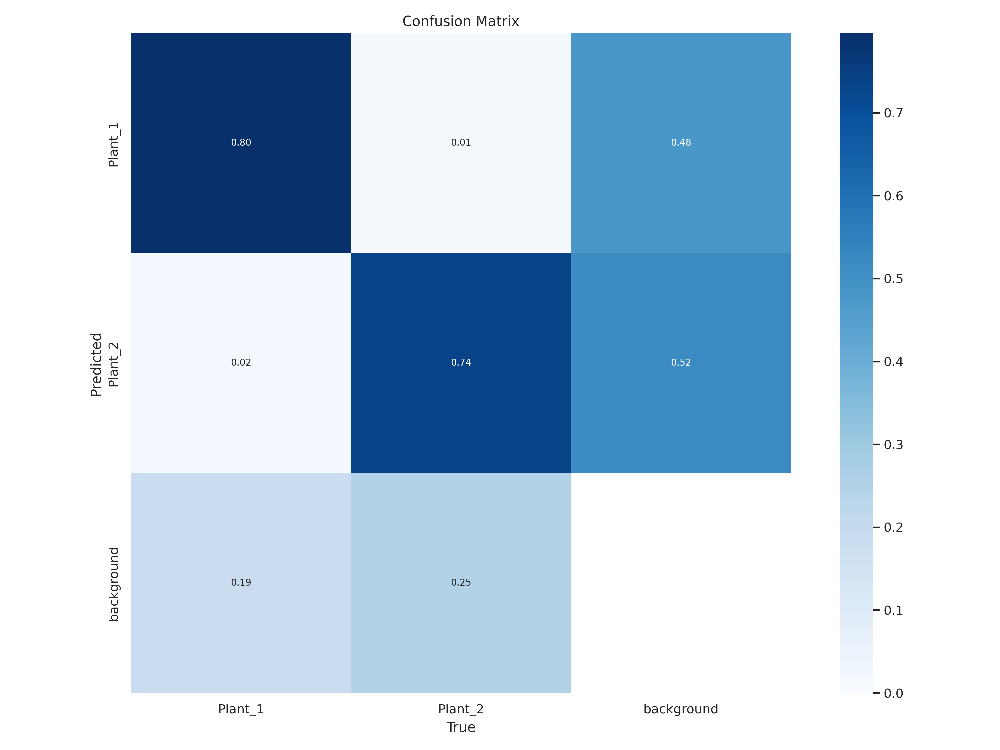

In [13]:
%cd {HOME}
Image(filename='/content/runs/segment/train3/confusion_matrix.png', width=600)

/content


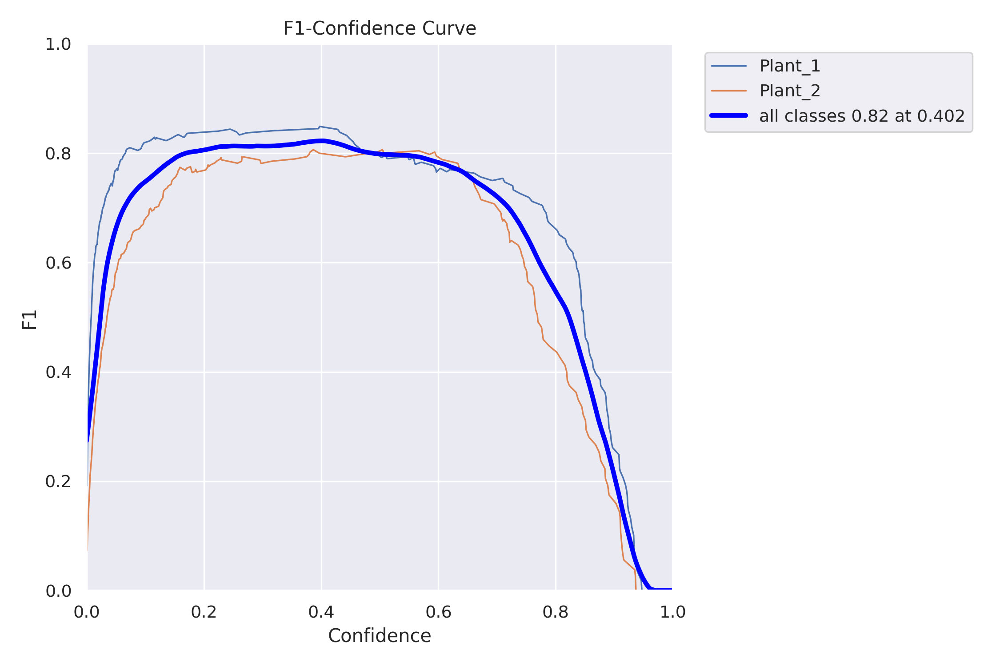

In [16]:
%cd {HOME}
Image(filename='/content/runs/segment/train3/BoxF1_curve.png', width=600)

/content


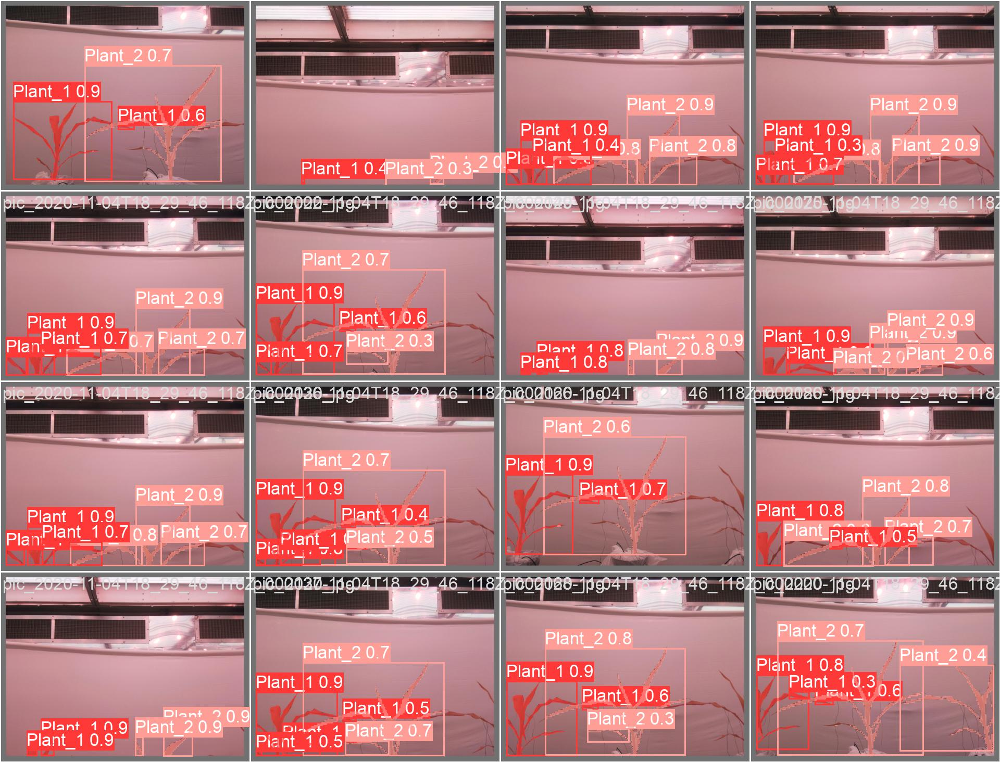

In [18]:
%cd {HOME}
Image(filename=f'{HOME}/runs/segment/train3/val_batch0_pred.jpg', width=600)

In [20]:
%cd {HOME}

!yolo task=segment mode=val model={HOME}/runs/segment/train3/weights/best.pt data={dataset.location}/data.yaml

/content
2023-04-26 18:59:23.309330: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11780374 parameters, 0 gradients, 42.4 GFLOPs
val: Scanning /content/datasets/NN_Project_200423-2/valid/labels.cache... 38 images, 0 backgrounds, 0 corrupt: 100% 38/38 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 3/3 [00:08<00:00,  2.97s/it]
                   all         38        217      0.907      0.756      0.853      0.715      0.896       0.75      0.847      0.564
               Plant_1         38        113        0.9      0.796      0.882      0.746      0.879      0.779      0.869      0.581
               Plant_2         38        104      0.914      0.716      0.824      0.684      0.913      0.721      0.825

In [21]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train3/weights/best.pt conf=0.25 source={dataset.location}/test/images save=true

/content
2023-04-26 19:00:55.899957: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11780374 parameters, 0 gradients, 42.4 GFLOPs

image 1/23 /content/NN_Project_200423-2/test/images/pic_2020-11-04T18_29_46_118Z_000016_jpg.rf.72171e03b687144bb51187191990cd42.jpg: 512x640 3 Plant_1s, 3 Plant_2s, 84.4ms
image 2/23 /content/NN_Project_200423-2/test/images/pic_2020-11-04T18_29_46_118Z_000020_jpg.rf.1604db41de64d83e0d7eaf44391aaad6.jpg: 512x640 3 Plant_1s, 3 Plant_2s, 17.0ms
image 3/23 /content/NN_Project_200423-2/test/images/pic_2020-11-04T18_29_46_118Z_000027_jpg.rf.09798af8917501a7032f6c39fc0d27d0.jpg: 512x640 1 Plant_1, 2 Plant_2s, 17.0ms
image 4/23 /content/NN_Project_200423-2/test/images/pic_2020-11-04T18_29_46_118Z_000031_jpg.rf.480801083f761b663a7a5a6780a59cf1.jpg: 512x640 1 Plant_1, 17.0ms
image 5/23 /content

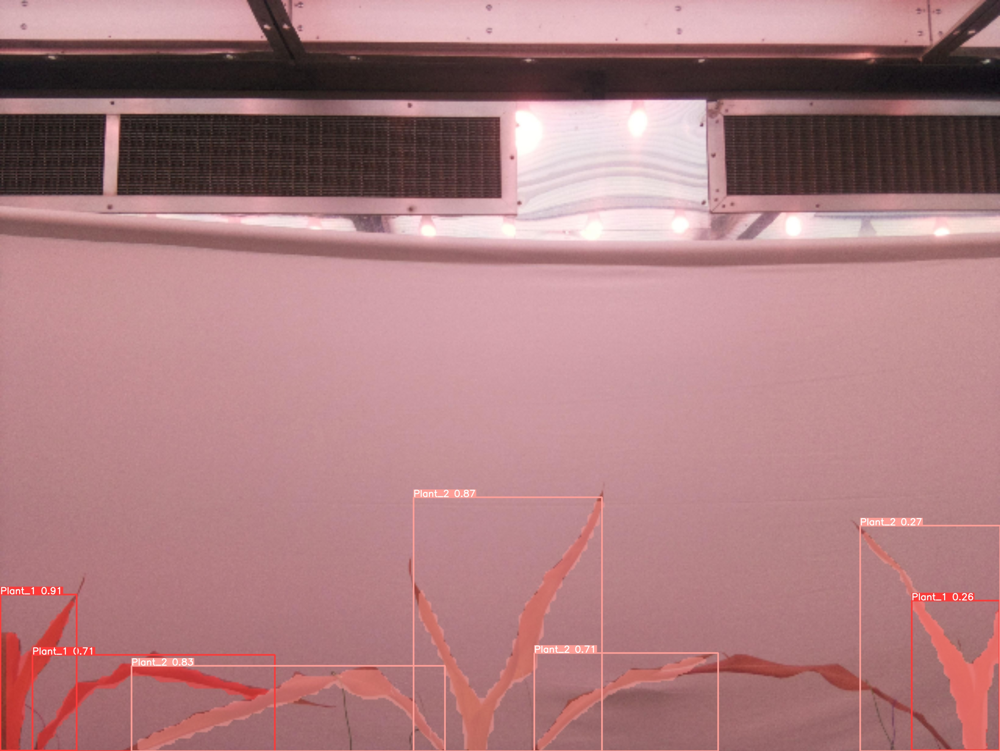

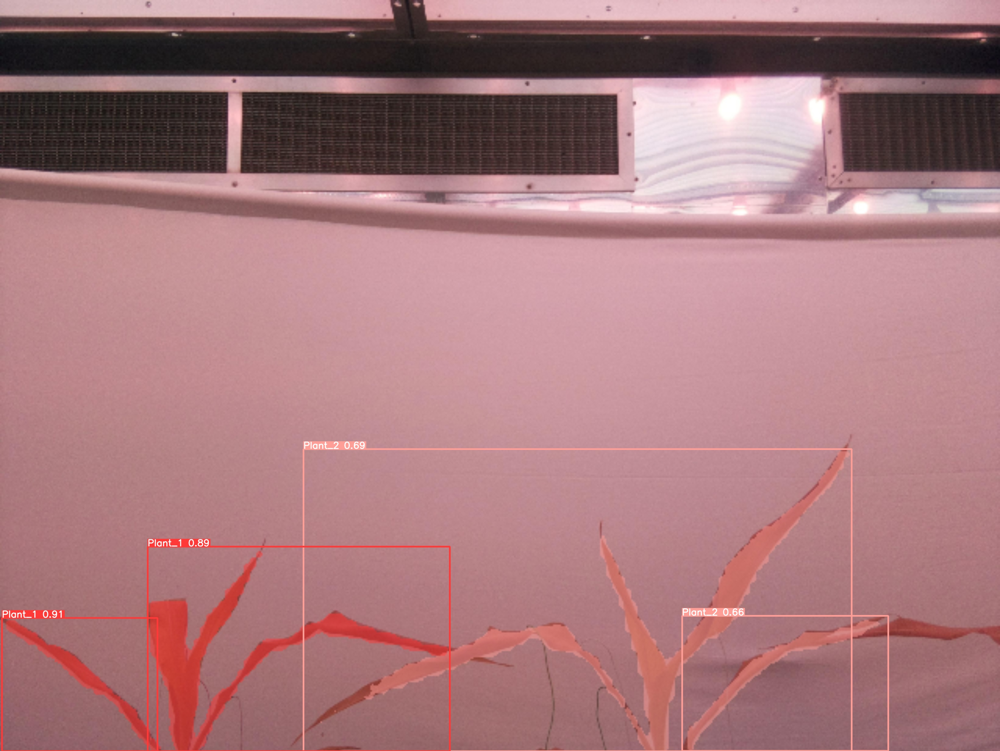

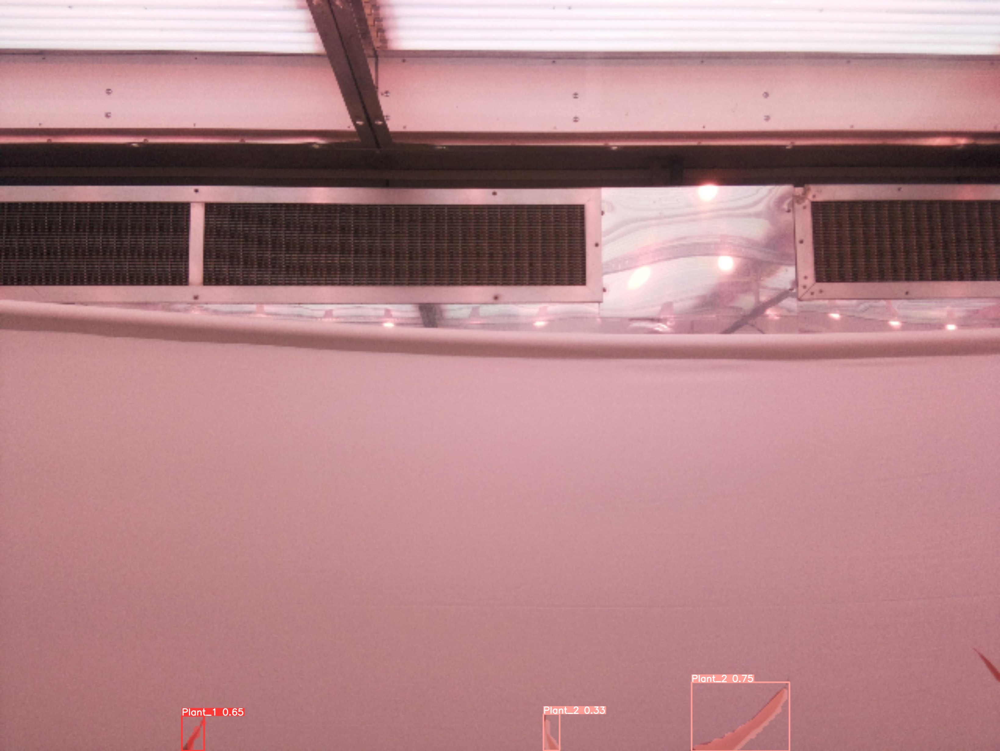

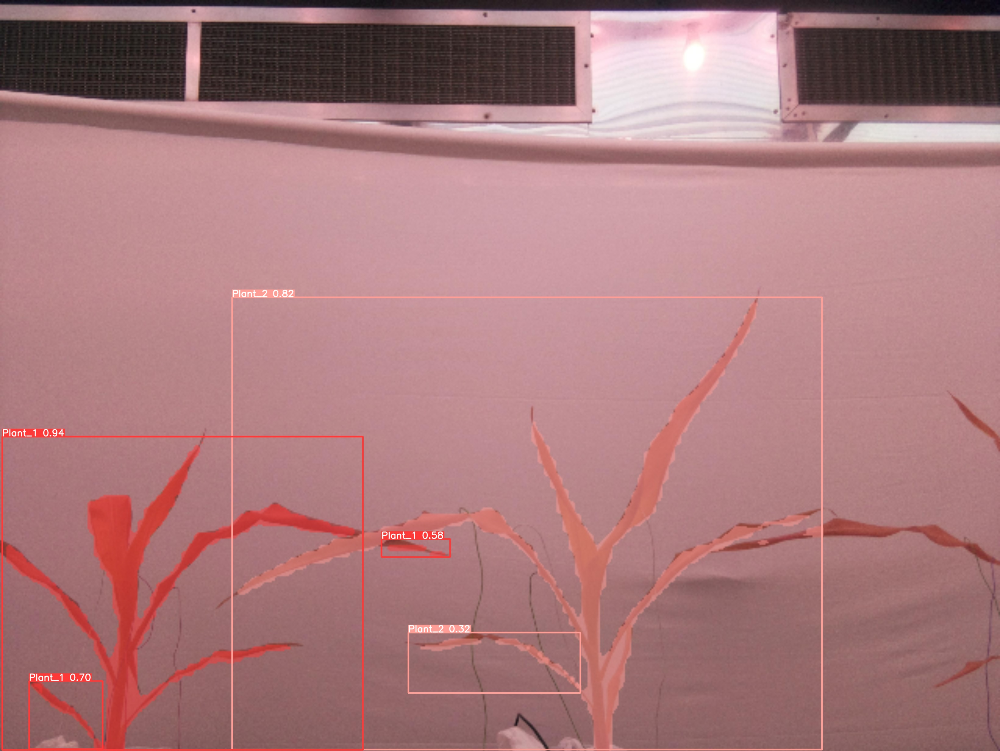

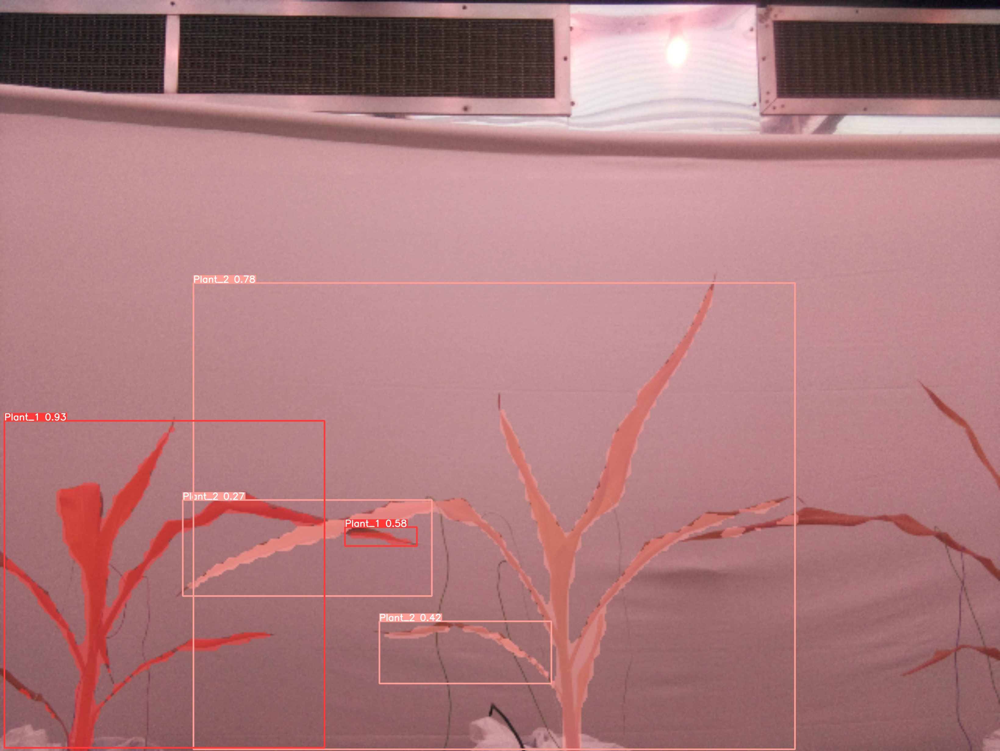

...

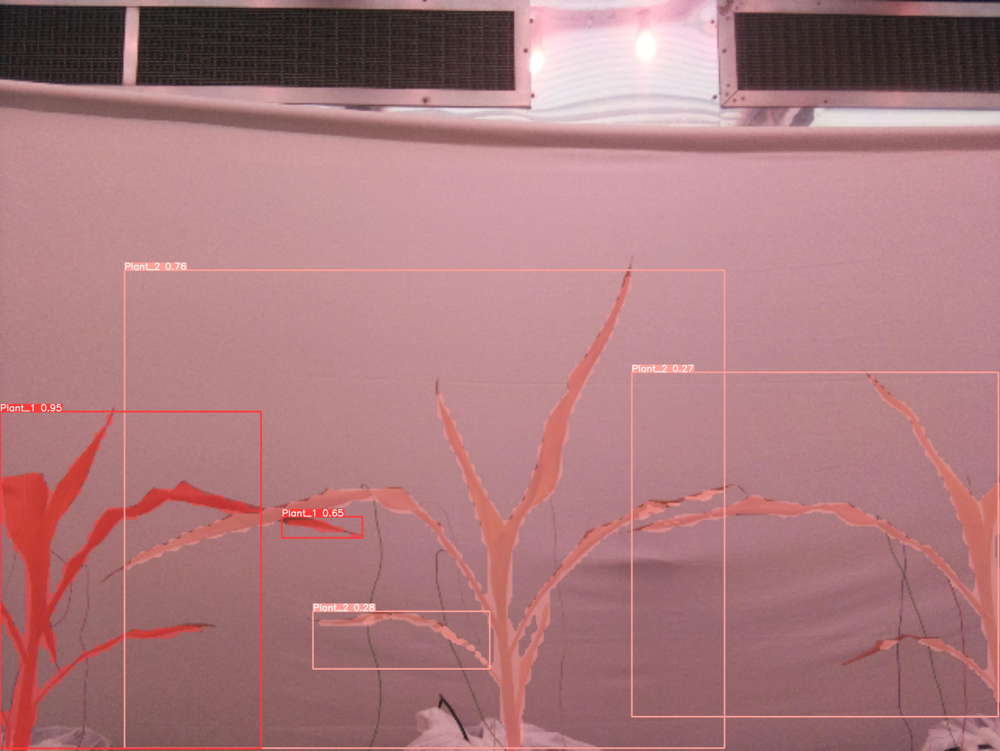

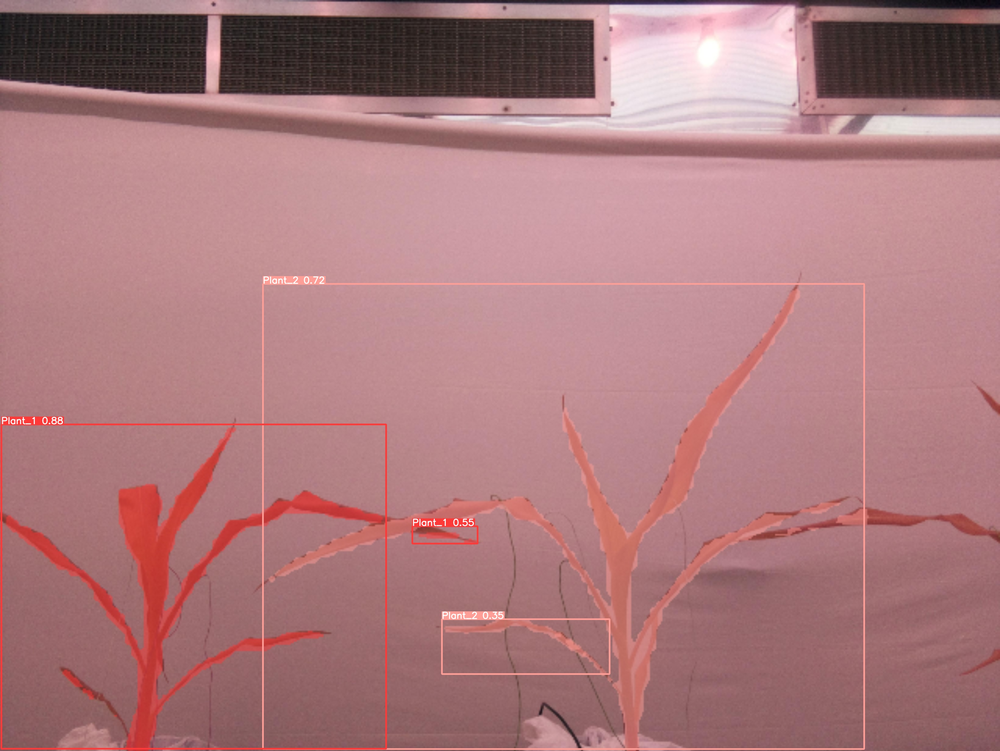

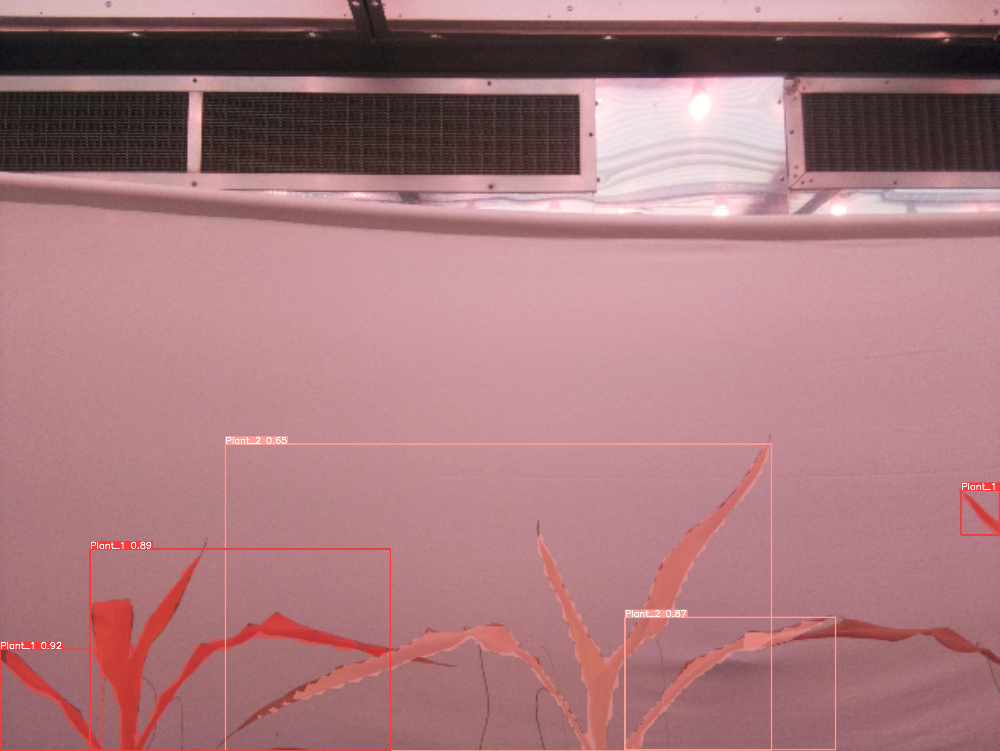

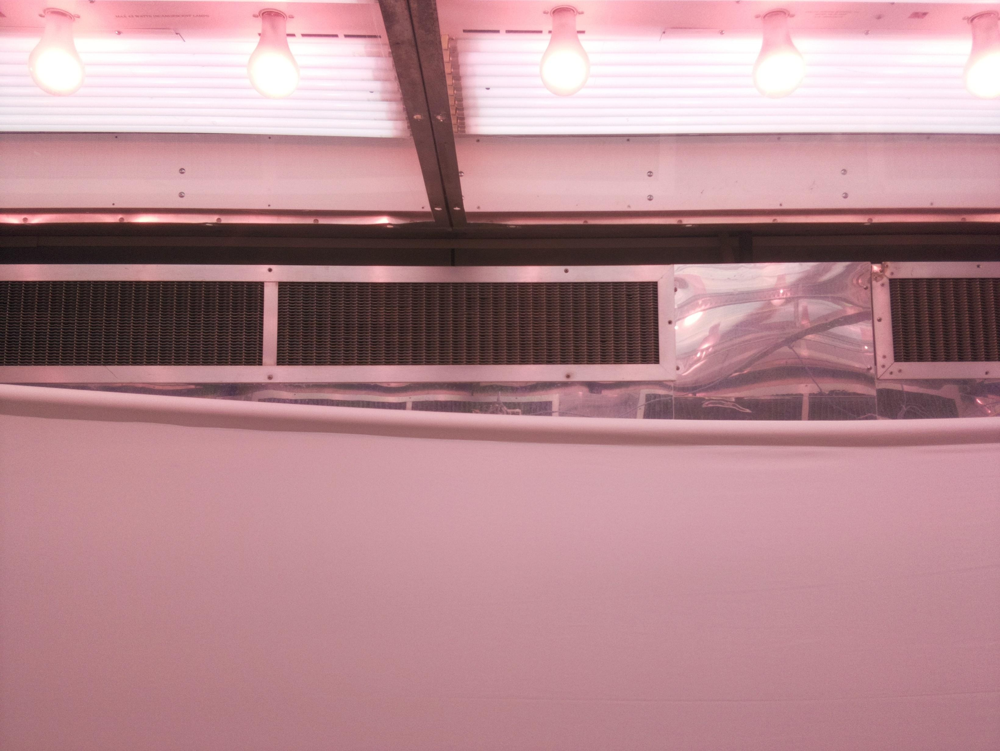

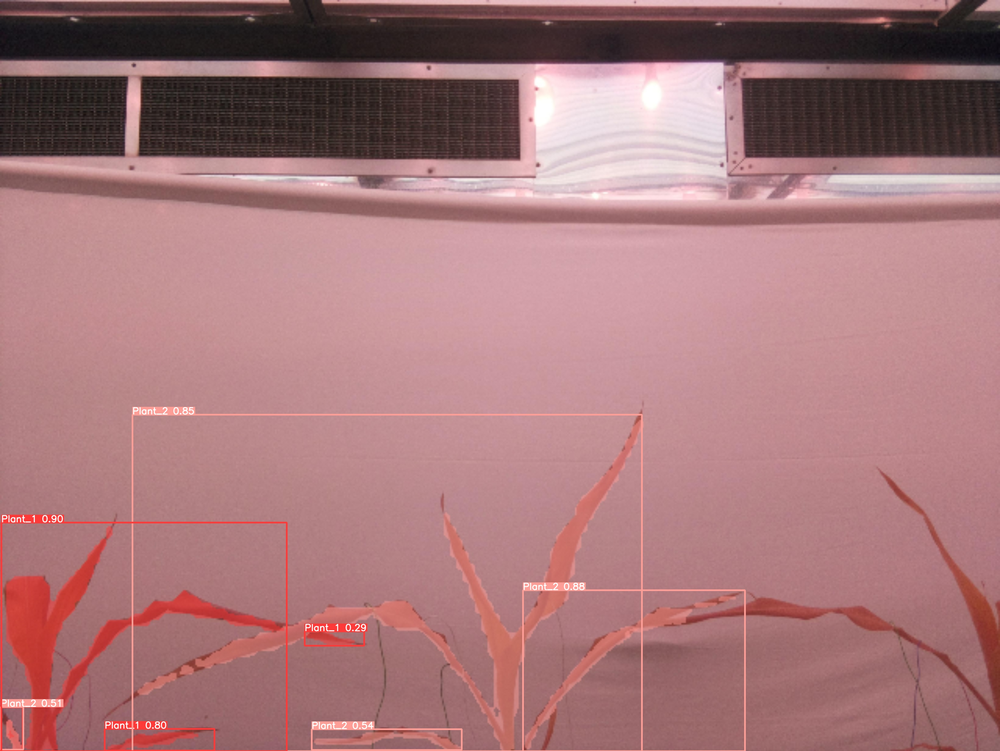

In [22]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/segment/predict/*.jpg')[:23]:
      display(Image(filename=image_path, height=600))
      print("\n")

In [23]:
%cd {HOME}
!yolo task=segment mode=predict model={HOME}/runs/segment/train3/weights/best.pt conf=0.25 source=/content/runs/segment/predict/pic_2020-11-04T18_29_46_118Z_000084_jpg.rf.db09d4ded2bca2e133adeeccc74e0732.jpg save=true save_txt=true

/content
2023-04-26 19:02:23.132174: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11780374 parameters, 0 gradients, 42.4 GFLOPs

image 1/1 /content/runs/segment/predict/pic_2020-11-04T18_29_46_118Z_000084_jpg.rf.db09d4ded2bca2e133adeeccc74e0732.jpg: 512x640 1 Plant_1, 3 Plant_2s, 88.6ms
Speed: 0.7ms pre-process, 88.6ms inference, 90.0ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/segment/predict2
1 label saved to runs/segment/predict2/labels


In [39]:
model = YOLO(f'{HOME}/runs/segment/train3/weights/last.pt')
results = model.predict(source='/content/runs/segment/predict/pic_2020-11-04T18_29_46_118Z_000243_jpg.rf.b186c6e5b6affa7f51feeeff4b02016a.jpg', conf=0.25)

Ultralytics YOLOv8.0.28 🚀 Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8s-seg summary (fused): 195 layers, 11780374 parameters, 0 gradients, 42.4 GFLOPs

image 1/1 /content/runs/segment/predict/pic_2020-11-04T18_29_46_118Z_000243_jpg.rf.b186c6e5b6affa7f51feeeff4b02016a.jpg: 512x640 1 Plant_1, 3 Plant_2s, 20.4ms
Speed: 0.7ms pre-process, 20.4ms inference, 5.3ms postprocess per image at shape (1, 3, 640, 640)


In [40]:
print(len(results))

1


In [37]:
results[0].boxes.xyxy

tensor([[ 948.,  882., 2069., 2441.],
        [2357., 1244., 3280., 2370.],
        [2855., 1237., 3278., 2364.]], device='cuda:0')

In [26]:
results[0].boxes.conf

tensor([0.56523, 0.42132, 0.37567, 0.27014], device='cuda:0')

In [27]:
results[0].boxes.cls

tensor([1., 1., 0., 1.], device='cuda:0')

In [28]:
results[0].masks.masks

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 

In [ ]:
import cv2
import numpy as np 
from google.colab.patches import cv2_imshow

In [ ]:
cv_imshow((results[0].masks,masks.numpy() * 255).astype("unit8"))

NameError: ignored

In [ ]:
results[0].masks.masks.shape

torch.Size([3, 512, 640])

In [ ]:
results[0].masks.masks[0]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')

In [ ]:
results[0].masks.masks[0].shape

torch.Size([512, 640])

In [ ]:
results[0].masks.masks[0].unique()

tensor([0., 1.], device='cuda:0')

In [ ]:
cv2_imshow((results[0].masks.masks[0].numpy() * 255).astype("unit8"))

TypeError: ignored

In [ ]:
masks = results[0].masks.masks[0]
masks_np = (masks.cpu().numpy() * 255).astype('uint8')

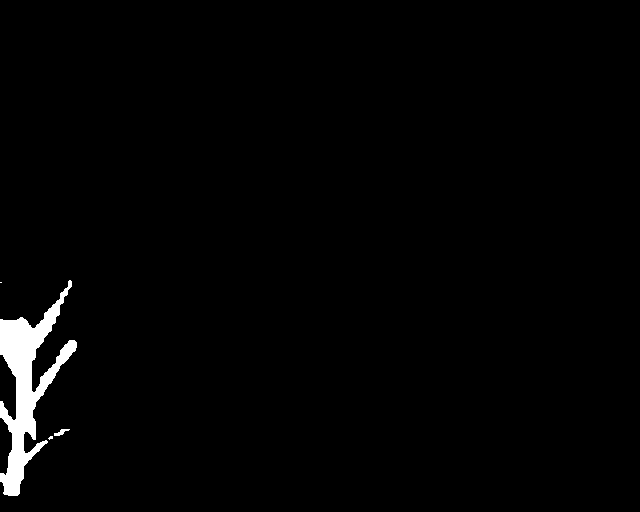

In [41]:
from google.colab.patches import cv2_imshow
import numpy as np

# Assuming 'results' is a list of object detection results
masks = results[0].masks.masks[1]
masks_np = (masks.cpu().numpy() * 255).astype('uint8')

# Display the mask using cv2_imshow()
cv2_imshow(masks_np)


In [ ]:
masks = results[0].masks.masks[0].cpu().numpy()
image = cv2.imread('/content/datasets/NN_Project_200423-2/test/images/pic_2020-11-04T18_29_46_118Z_000084_jpg.rf.db09d4ded2bca2e133adeeccc74e0732.jpg')  # Replace with your image file path
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [ ]:
background = np.ones_like(image) * 255

In [ ]:
overlay = np.zeros_like(image)
overlay[masks[:, :, 0] > 0.5] = image[masks[:, :, 0] > 0.5]
alpha = 0.5  # Adjust the alpha value as needed
output = cv2.addWeighted(overlay, alpha, background, 1 - alpha, 0)

IndexError: ignored